# Notebook to check/remove duplicates from HAM10000 dataset - skin cancer

###  Import packages

In [1]:
import os
import pandas as pd
import numpy as np

from PIL import Image
import cv2
import random

from skimage import io
from skimage.metrics import mean_squared_error
from skimage.metrics import structural_similarity as ssim

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

/var/folders/f_/5k17103s6dx_p4d2kxxkf3p40000gn/T/ipykernel_4157/2676945590.py:2: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


### Read metadata csv file

In [2]:
main_dir = "dataset_HAM10000"
csv_path = os.path.join(main_dir, "HAM10000_metadata.csv")
df = pd.read_csv(csv_path)
df.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear


In [3]:
print(f"There are {len(df)} images in the dataset but only {len(df.lesion_id.unique())} different 'lesion_id'. This means there are duplicates.")

There are 10015 images in the dataset but only 7470 different 'lesion_id'. This means there are duplicates.


In [4]:
# Mapping the types of tumors in their scientific name
lesion_type_dict = {
    'nv': 'Melanocytic nevi',
    'mel': 'Melanoma',
    'bkl': 'Benign keratosis-like lesions',
    'bcc': 'Basal cell carcinoma',
    'akiec': 'Actinic keratoses',
    'vasc': 'Vascular lesions',
    'df': 'Dermatofibroma'
}

df['dx'] = df.dx.map(lesion_type_dict)

df.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization
0,HAM_0000118,ISIC_0027419,Benign keratosis-like lesions,histo,80.0,male,scalp
1,HAM_0000118,ISIC_0025030,Benign keratosis-like lesions,histo,80.0,male,scalp
2,HAM_0002730,ISIC_0026769,Benign keratosis-like lesions,histo,80.0,male,scalp
3,HAM_0002730,ISIC_0025661,Benign keratosis-like lesions,histo,80.0,male,scalp
4,HAM_0001466,ISIC_0031633,Benign keratosis-like lesions,histo,75.0,male,ear


# Getting the whole paths

In [5]:
## Code from https://github.com/marmal88/computer_vision_toolkit/blob/main/notebooks/1.1_basic_EDA.ipynb 

def make_dataframe(path):
    filepath, img_mode=[], []
    img_height, img_width=[], []
    img_format= []
    errorpath=[]
    for root, _, files in os.walk(path):
        for f in files:
            file_path = os.path.join(root, f)
            try:
                img = Image.open(file_path)
                filepath.append(file_path)
                img_mode.append(img.mode)
                img_height.append(img.height)
                img_width.append(img.width)
                img_format.append(img.format)

            except:
                errorpath.append(file_path)

        df = pd.DataFrame.from_dict({
            "filepath":filepath, 
            "mode":img_mode, 
            "height": img_height,
            "width": img_width,
            "format": img_format})

        df["directory"] = df["filepath"].apply(lambda x: x.split('/')[-2])
        df["file_name"] = df["filepath"].apply(lambda x: x.split('/')[-1].split('.')[0])

    return df

In [6]:
# check and inspect dataframe
path = main_dir
photo_df = make_dataframe(path)
photo_df.shape
# There are 3 lines due to hidden jupyter notebook files .ipynb_checkpoints	-> To remove after merging this dataframe with the original one

(10015, 7)

In [7]:
photo_df.head()

,filepath,mode,height,width,format,directory,file_name
0,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0026784
1,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0028971
2,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0026948
3,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0026790
4,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0028965


In [8]:
# Merge photo_df with df
new_df = photo_df.merge(df, how="outer", left_on='file_name', right_on='image_id', suffixes=('_x', '_y'))

# Mapping the conditions to the various labels
labels = {
    'Melanocytic nevi': 1,
    'Melanoma': 2,
    'Benign keratosis-like lesions': 3,
    'Basal cell carcinoma': 4,
    'Actinic keratoses': 5,
    'Vascular lesions': 6,
    'Dermatofibroma': 7
}

new_df['label'] = new_df.dx.map(labels)
new_df.head()

,filepath,mode,height,width,format,directory,file_name,lesion_id,image_id,dx,dx_type,age,sex,localization,label
0,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024306,HAM_0000550,ISIC_0024306,Melanocytic nevi,follow_up,45.0,male,trunk,1
1,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024307,HAM_0003577,ISIC_0024307,Melanocytic nevi,follow_up,50.0,male,lower extremity,1
2,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024308,HAM_0001477,ISIC_0024308,Melanocytic nevi,follow_up,55.0,female,trunk,1
3,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024309,HAM_0000484,ISIC_0024309,Melanocytic nevi,follow_up,40.0,male,trunk,1
4,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024310,HAM_0003350,ISIC_0024310,Melanoma,histo,60.0,male,chest,2


In [9]:
# Remove the 3 lines due to hidden jupyter notebook files .ipynb_checkpoints	
new_df.drop(new_df.loc[new_df.directory == ".ipynb_checkpoints"].index, inplace=True)
print(new_df.shape)

(10015, 15)


In [10]:
# Save the dataframe
new_df.to_csv('all_paths_metadata_df.csv', index=False)

In [11]:
new_df

,filepath,mode,height,width,format,directory,file_name,lesion_id,image_id,dx,dx_type,age,sex,localization,label
0,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024306,HAM_0000550,ISIC_0024306,Melanocytic nevi,follow_up,45.0,male,trunk,1
1,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024307,HAM_0003577,ISIC_0024307,Melanocytic nevi,follow_up,50.0,male,lower extremity,1
2,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024308,HAM_0001477,ISIC_0024308,Melanocytic nevi,follow_up,55.0,female,trunk,1
3,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024309,HAM_0000484,ISIC_0024309,Melanocytic nevi,follow_up,40.0,male,trunk,1
4,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024310,HAM_0003350,ISIC_0024310,Melanoma,histo,60.0,male,chest,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10010,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0034316,HAM_0004304,ISIC_0034316,Melanoma,histo,85.0,male,upper extremity,2
10011,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0034317,HAM_0006376,ISIC_0034317,Melanoma,histo,70.0,female,lower extremity,2
10012,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0034318,HAM_0000344,ISIC_0034318,Benign keratosis-like lesions,histo,55.0,male,trunk,3
10013,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0034319,HAM_0000747,ISIC_0034319,Melanocytic nevi,histo,30.0,male,trunk,1


# Check duplicates by plotting the corresponding images for a given "lesion_id"

In [12]:
duplicates = new_df[new_df.duplicated(subset=['lesion_id', 'dx', 'dx_type', 'age', 'sex', 'localization'], keep=False)]
duplicates.sort_values(by=['lesion_id'])


,filepath,mode,height,width,format,directory,file_name,lesion_id,image_id,dx,dx_type,age,sex,localization,label
4192,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0028498,HAM_0000000,ISIC_0028498,Melanocytic nevi,histo,60.0,male,back,1
1040,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0025346,HAM_0000000,ISIC_0025346,Melanocytic nevi,histo,60.0,male,back,1
8316,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0032622,HAM_0000002,ISIC_0032622,Melanoma,histo,65.0,female,lower extremity,2
9542,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0033848,HAM_0000002,ISIC_0033848,Melanoma,histo,65.0,female,lower extremity,2
9940,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0034246,HAM_0000002,ISIC_0034246,Melanoma,histo,65.0,female,lower extremity,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
320,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024626,HAM_0007621,ISIC_0024626,Benign keratosis-like lesions,histo,70.0,male,back,3
9072,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0033378,HAM_0007625,ISIC_0033378,Benign keratosis-like lesions,histo,75.0,male,lower extremity,3
9430,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0033736,HAM_0007625,ISIC_0033736,Benign keratosis-like lesions,histo,75.0,male,lower extremity,3
1812,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0026118,HAM_0007627,ISIC_0026118,Basal cell carcinoma,histo,80.0,male,chest,4


In [13]:
duplicates.to_csv('duplicates_df.csv', index=False)

# Extract paths of duplicates for plotting

In [14]:
grouped_df = duplicates.groupby('lesion_id').agg({'image_id': list, 'filepath': list}).reset_index()

# Print or display the resulting DataFrame
grouped_df.head()


,lesion_id,image_id,filepath
0,HAM_0000000,"[ISIC_0025346, ISIC_0028498]",[dataset_HAM10000/HAM10000_images_part_1/ISIC_...
1,HAM_0000002,"[ISIC_0032622, ISIC_0033848, ISIC_0034246]",[dataset_HAM10000/HAM10000_images_part_2/ISIC_...
2,HAM_0000005,"[ISIC_0024579, ISIC_0025577, ISIC_0029638, ISI...",[dataset_HAM10000/HAM10000_images_part_1/ISIC_...
3,HAM_0000006,"[ISIC_0032187, ISIC_0032583, ISIC_0034162]",[dataset_HAM10000/HAM10000_images_part_2/ISIC_...
4,HAM_0000009,"[ISIC_0026439, ISIC_0029201, ISIC_0029779]",[dataset_HAM10000/HAM10000_images_part_1/ISIC_...


In [15]:
duplicates_list = grouped_df.filepath.to_list()
lesion_id_duplicates = grouped_df.lesion_id.to_list()

In [16]:
duplicates_list_subsample = [['Skin_Cancer_MNIST_HAM10000/HAM10000_images_part_1/ISIC_0025346.jpg',
  'Skin_Cancer_MNIST_HAM10000/HAM10000_images_part_1/ISIC_0028498.jpg'],
 ['Skin_Cancer_MNIST_HAM10000/HAM10000_images_part_2/ISIC_0032622.jpg',
  'Skin_Cancer_MNIST_HAM10000/HAM10000_images_part_2/ISIC_0033848.jpg',
  'Skin_Cancer_MNIST_HAM10000/HAM10000_images_part_2/ISIC_0034246.jpg'],
 ['Skin_Cancer_MNIST_HAM10000/HAM10000_images_part_1/ISIC_0024579.jpg',
  'Skin_Cancer_MNIST_HAM10000/HAM10000_images_part_1/ISIC_0025577.jpg',
  'Skin_Cancer_MNIST_HAM10000/HAM10000_images_part_2/ISIC_0029638.jpg',
  'Skin_Cancer_MNIST_HAM10000/HAM10000_images_part_2/ISIC_0030591.jpg']]

In [17]:
# Function to subplot images
def subplot_images(image_paths, titles, rows, cols):
    fig = plt.figure(figsize=(10, 10))
    grid = gridspec.GridSpec(rows, cols, wspace=0.1, hspace=0.2)

    for i, image_path in enumerate(image_paths):
        ax = plt.subplot(grid[i])
        ax.imshow(io.imread(image_path))
        ax.set_title(titles[i])
        ax.axis("off")


/var/folders/f_/5k17103s6dx_p4d2kxxkf3p40000gn/T/ipykernel_4157/2598179349.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(10, 10))


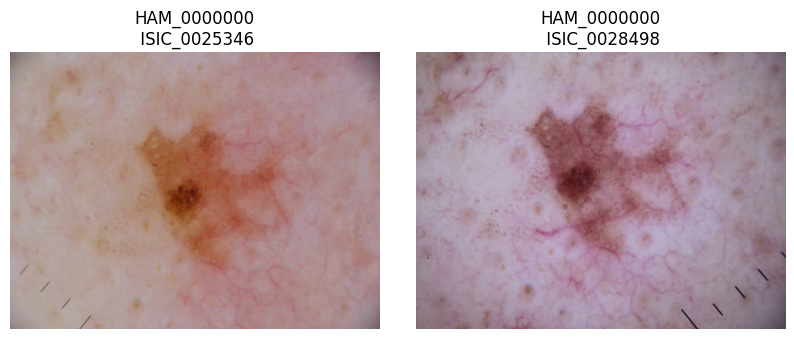

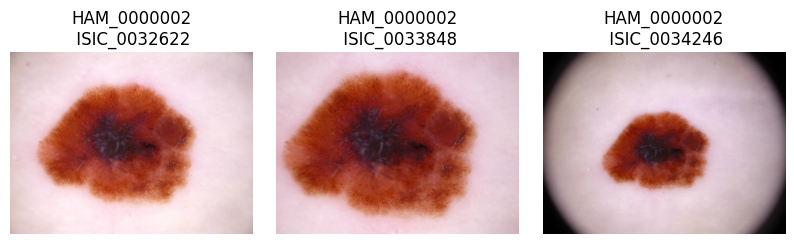

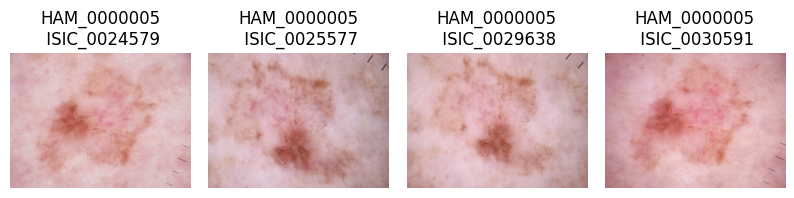

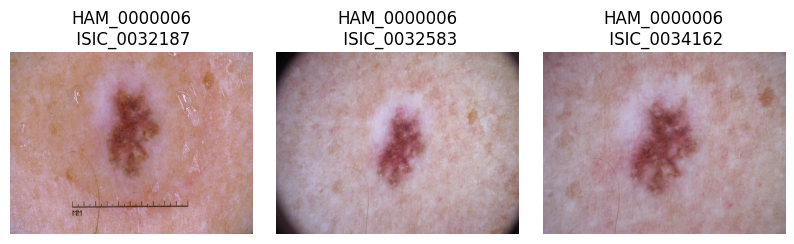

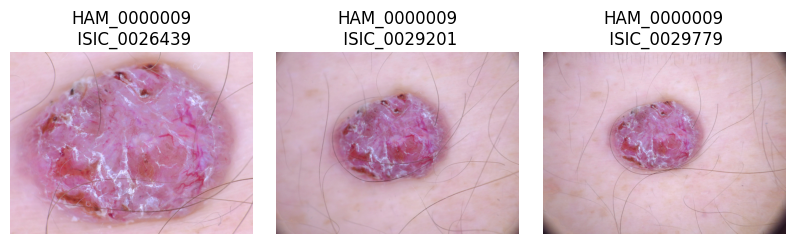

...

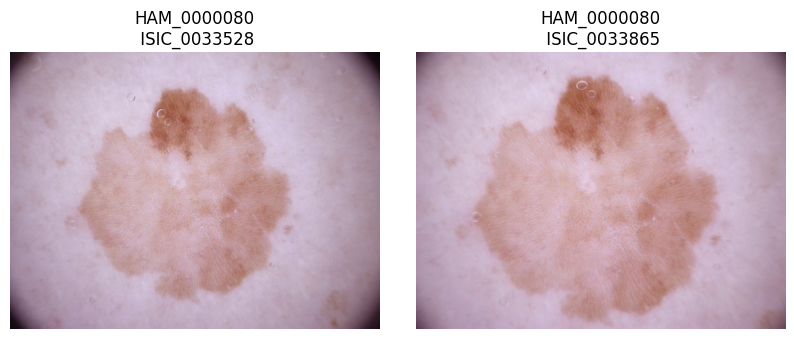

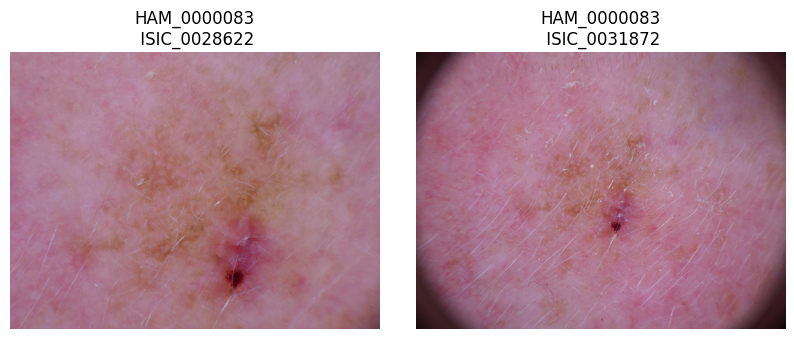

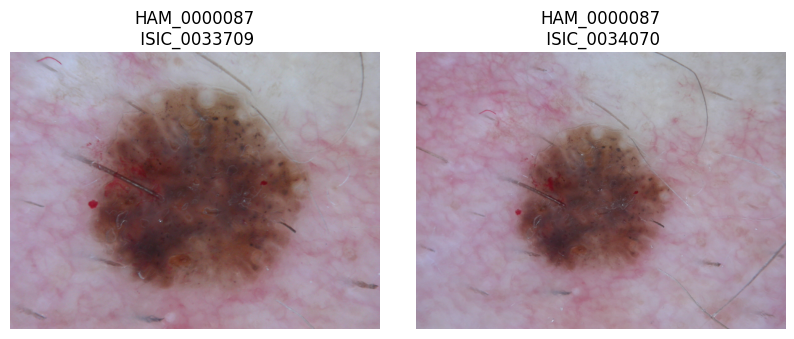

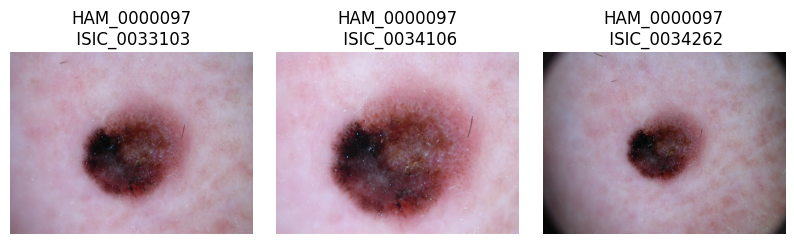

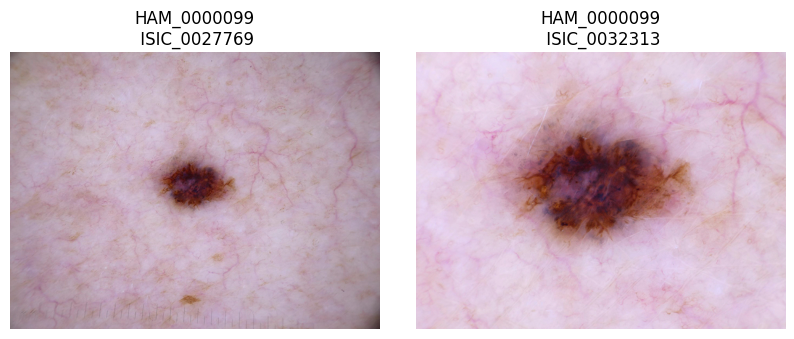

In [18]:
# Subplot duplicated images
start_ind = 0
stop_ind = 30

for i, (lesion_id, duplicated_pair) in enumerate(zip(lesion_id_duplicates[start_ind:stop_ind], duplicates_list[start_ind:stop_ind])):
    titles = [f"{lesion_id}\n {duplicated_pair[j].split('/')[-1].split('.')[0]}" for j in range(len(duplicated_pair))]
    subplot_images(duplicated_pair, titles, 1, len(duplicated_pair))

plt.show()

## Ideas : how to choose the best images from a list of duplicates ? 


# Plot images from the dataset 

In [19]:
new_df

,filepath,mode,height,width,format,directory,file_name,lesion_id,image_id,dx,dx_type,age,sex,localization,label
0,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024306,HAM_0000550,ISIC_0024306,Melanocytic nevi,follow_up,45.0,male,trunk,1
1,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024307,HAM_0003577,ISIC_0024307,Melanocytic nevi,follow_up,50.0,male,lower extremity,1
2,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024308,HAM_0001477,ISIC_0024308,Melanocytic nevi,follow_up,55.0,female,trunk,1
3,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024309,HAM_0000484,ISIC_0024309,Melanocytic nevi,follow_up,40.0,male,trunk,1
4,dataset_HAM10000/HAM10000_images_part_1/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_1,ISIC_0024310,HAM_0003350,ISIC_0024310,Melanoma,histo,60.0,male,chest,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10010,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0034316,HAM_0004304,ISIC_0034316,Melanoma,histo,85.0,male,upper extremity,2
10011,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0034317,HAM_0006376,ISIC_0034317,Melanoma,histo,70.0,female,lower extremity,2
10012,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0034318,HAM_0000344,ISIC_0034318,Benign keratosis-like lesions,histo,55.0,male,trunk,3
10013,dataset_HAM10000/HAM10000_images_part_2/ISIC_0...,RGB,450,600,JPEG,HAM10000_images_part_2,ISIC_0034319,HAM_0000747,ISIC_0034319,Melanocytic nevi,histo,30.0,male,trunk,1


In [20]:
# Function to subplot images
def subplot_random_images(df, variable_to_plot, variable_value, n = 3):
    
    # Filter DataFrame for the given variable
    filtered_df = df[df[variable_to_plot] == variable_value]
    
    # Sample n rows randomly
    random_samples = filtered_df.sample(n)
    
    # Plot the images
    fig = plt.figure(figsize=(n/2*15, n/2*5))  # Adjust figsize as needed
    gs = gridspec.GridSpec(1, n, width_ratios=[1] * n)
    for i, (index, row) in enumerate(random_samples.iterrows()):
        filepath = row['filepath']
        lesion_id = row['lesion_id']
        
        # Load and plot the image using your preferred method
        # For example, using matplotlib:
        img = plt.imread(filepath)

        ax = plt.subplot(gs[i])
        ax.imshow(img)
        ax.axis('off')  # Optional: turn off axis
        ax.set_title(f"{variable_to_plot}:  {variable_value}\n lesion_id:  {lesion_id}\n image_id:  {filepath.split('/')[-1].split('.')[0]}")
    
    plt.show()
    


## Plot examples of each 'dx'

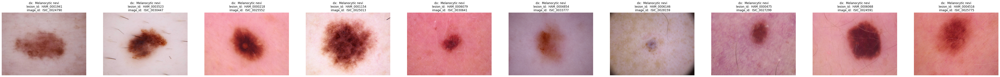

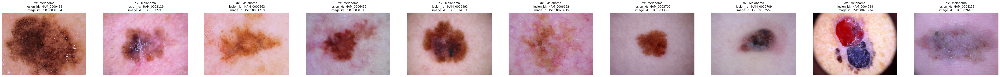

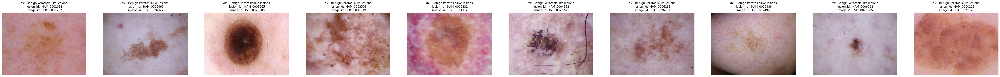

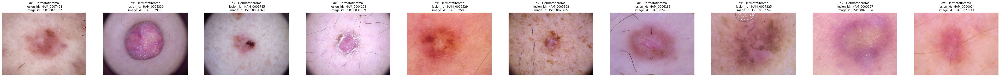

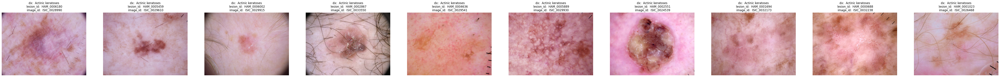

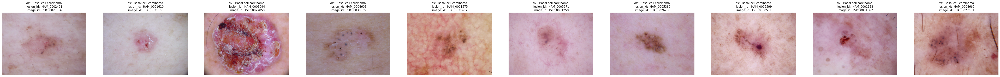

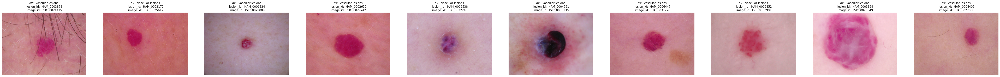

In [21]:
variable_to_plot='dx'
variable_value = 'Melanocytic nevi'  # Replace with the desired value
n = 10  # Replace with the desired number of file paths to plot

for variable_value in new_df.dx.unique():
    subplot_random_images(new_df, variable_to_plot, variable_value, n)
